<a href="https://colab.research.google.com/github/ajitkumarkp/ML/blob/master/Pytorch_License_plate_detection_proj3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <font style="color:blue">Project 3: Object Detection-ANPR</font>

This project solves the **License plate detection** problem. 
**ANPR (Automatic Number Plate Recognition)** is an integral part of the Electronic Toll Collection. Detecting the number plate is a prerequisite to solving the ANPR problem. 

This notebook has the following sections:

1. Plot Ground Truth Bounding Boxes
2. Training
3. Inference
4. COCO Detection Evaluation
5. Run Inference on a Video


   






#### Maximum Points: 100

<div>
    <table>
        <tr><td><h3>Sr. no.</h3></td> <td><h3>Section</h3></td> <td><h3>Points</h3></td> </tr>
        <tr><td><h3>1</h3></td> <td><h3>Plot Ground Truth Bounding Boxes</h3></td> <td><h3>20</h3></td> </tr>
        <tr><td><h3>2</h3></td> <td><h3>Training</h3></td> <td><h3>25</h3></td> </tr>
        <tr><td><h3>3</h3></td> <td><h3>Inference</h3></td> <td><h3>15</h3></td> </tr>
        <tr><td><h3>4</h3></td> <td><h3>COCO Detection Evaluation</h3></td> <td><h3>25</h3></td> </tr>
        <tr><td><h3>5</h3></td> <td><h3>Run Inference on a Video</h3></td> <td><h3>15</h3></td> </tr>
    </table>
</div>


# <font style="color:purple">Download the Dataset</font> 

**[Download the Vehicle registration plate](https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1)**


Download the Vehicle Registration Plate dataset from [here](https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1) and unzip it. 

We will have the following directory structure:

```
Dataset
├── train
│   └── Vehicle registration plate
│       └── Label
└── validation
    └── Vehicle registration plate
        └── Label
```

Unzipping the file will give you a directory `Dataset`. This directory has two folder `train` and `validation`. Each train and validation folder has `Vehicle registration plate`  folder with `.jpg` images and a folder `Labels`.  `Labels` folder has bounding box data for the images.


For example,
For image: `Dataset/train/Vehicle registration plate/bf4689922cdfd532.jpg`
Label file is  `Dataset/train/Vehicle registration plate/Label/bf4689922cdfd532.txt`

There are one or more lines in each `.txt` file. Each line represents one bounding box.
For example,
```
Vehicle registration plate 385.28 445.15 618.24 514.225
Vehicle registration plate 839.68 266.066462 874.24 289.091462
```

We have a single class detection (`Vehicle registration plate detection`) problem. So bounding box details start from the fourth column in each row.

Representation is in `xmin`, `ymin`, `xmax`, and `ymax` format.

**It has `5308` training and `386` validation dataset.**

Data is downloaded from [Open Images Dataset](https://storage.googleapis.com/openimages/web/index.html)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/ 

/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector


In [ ]:
# !wget https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1

In [ ]:
# !rm -rf Dataset

In [ ]:
# !unzip Dataset.zip

In [ ]:
# %cd /content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/Dataset

In [ ]:
%pip install albumentations==0.4.2


In [ ]:
%matplotlib inline

%load_ext tensorboard
# %matplotlib notebook
%load_ext autoreload
%autoreload 2

import os
import random

from operator import itemgetter

import cv2
import numpy as np
import torch
import torch.optim as optim
import matplotlib.pyplot as plt

import matplotlib
matplotlib.rcParams['figure.figsize'] = (10.0,10.0)
matplotlib.rcParams['image.cmap'] = 'gray'

from albumentations import (
    CLAHE,
    Blur,
    OneOf,
    Compose,
    RGBShift,
    GaussNoise,
    RandomGamma,
    RandomContrast,
    RandomBrightness,
)

from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import MultiStepLR
from albumentations.pytorch.transforms import ToTensorV2
from albumentations.augmentations.transforms import HueSaturationValue
from albumentations.augmentations.transforms import Normalize

from trainer import Trainer, hooks, configuration
from detector import Detector
from trainer.utils import patch_configs
from trainer.utils import setup_system
from detection_loss import DetectionLoss
from trainer.encoder import (
    DataEncoder,
    decode_boxes,
    encode_boxes,
    generate_anchors,
    generate_anchor_grid,
)
from trainer.metrics import APEstimator
from trainer.datasets import ListDataset
from trainer.data_set_downloader import DataSetDownloader 
from trainer.matplotlib_visualizer import MatplotlibVisualizer

from trainer.tensorboard_visualizer import TensorBoardVisualizer
from torch.utils.tensorboard import SummaryWriter



The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
# import os
val_data_root = '/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/data/VehLPR/validation/Vehicle_registration_plate/'
train_data_root = '/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/data/VehLPR/train/Vehicle_registration_plate/'

path, dirs, files = next(os.walk(train_data_root))
file_count = len(files)
print("Total images in {}: {}".format(train_data_root, file_count))

path, dirs, files = next(os.walk(val_data_root))
file_count = len(files)
print("Total images in {}: {}".format(val_data_root, file_count))


Total images in /content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/data/VehLPR/train/Vehicle_registration_plate/: 5308
Total images in /content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/data/VehLPR/validation/Vehicle_registration_plate/: 386


#  <font style="color:green">1. Plot Ground Truth Bounding Boxes [20 Points]</font> 

**Goal is to show three images from validation data with the bounding boxes.**


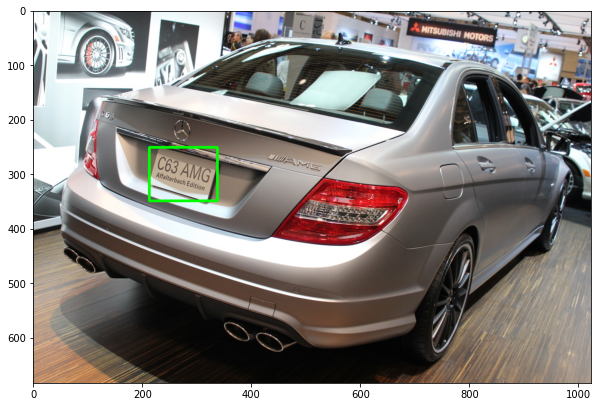

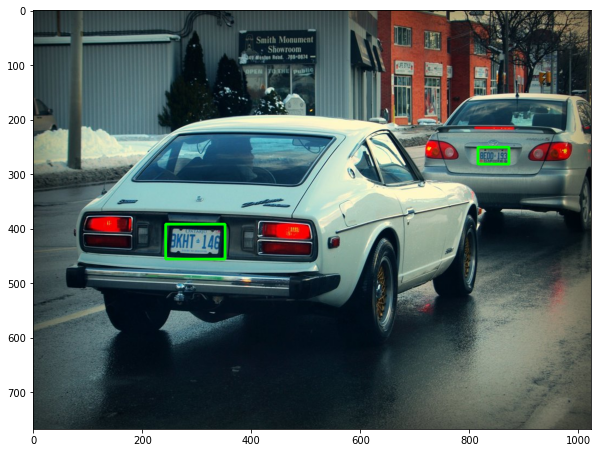

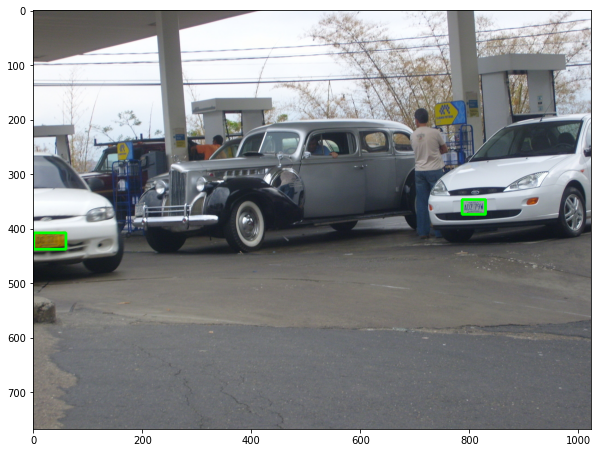

In [ ]:
for i in range(3):
  img = cv2.imread(val_data_root+str(files[i]))
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  val_label = val_data_root+"Label/"+str(files[i]).split(".")[0]+".txt"
  with open(val_label, 'r') as f:
    lines = f.readlines()
    for line in lines:
      xmin, ymin, xmax, ymax = line.split()[-4:]
      cv2.rectangle(img, (int(float(xmin)), int(float(ymin))), (int(float(xmax)), int(float(ymax))), (0, 255, 0), 3)
    plt.imshow(img); plt.show()

In [ ]:
!pwd

/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector


In [ ]:
# Commnet the below code (just needed to run once) to create the annotation file.
val_data_root='/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/data/VehLPR/validation/Vehicle_registration_plate/'
train_data_root='/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/data/VehLPR/train/Vehicle_registration_plate/'

root_dir="validation/Vehicle_registration_plate/"

path, dirs, files = next(os.walk(val_data_root))
with open("/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/data/test_anno.txt", "w") as f_anno:
  for file in files:
    label = val_data_root+"Label/"+str(file).split(".")[0]+".txt"
    # print(label)

    with open(label, 'r') as f_label:
      lines = f_label.readlines()
      f_anno.write(root_dir+file+" ")
      for line in lines:
        xmin, ymin, xmax, ymax = line.split()[-4:]
        xmin=str(int(float(xmin)))
        ymin=str(int(float(ymin))) 
        xmax=str(int(float(xmax)))
        ymax=str(int(float(ymax)))
        all_anno = xmin+" "+ymin+" "+xmax+" "+ymax+" "+"1"+" "
        f_anno.write(all_anno) 
      f_anno.write("\n") 


In [ ]:
class myTensorBoardVisualizer(TensorBoardVisualizer):
  def __init__(self):
        self._writer = SummaryWriter("./runs/testing_2")

#  <font style="color:green">2. Training [25 Points]</font> 

- **Write your training code in this section.**

- **You also have to share ([shared logs example](https://tensorboard.dev/experiment/JRtnsKbwTaq1ow6nPLPGeg)) the loss plot of your training using tensorboard.dev.** 



In [ ]:
class Experiment:
    def __init__(
        self,
        system_config: configuration.SystemConfig = configuration.SystemConfig(),
        dataset_config: configuration.DatasetConfig = configuration.DatasetConfig(),  # pylint: disable=redefined-outer-name
        dataloader_config: configuration.DataloaderConfig = configuration.DataloaderConfig(),  # pylint: disable=redefined-outer-name
        optimizer_config: configuration.OptimizerConfig = configuration.OptimizerConfig(),  # pylint: disable=redefined-outer-name
    ):
        self.system_config = system_config
        setup_system(system_config)
        self.dataset_train = ListDataset(
            root_dir=dataset_config.root_dir,
            list_file='../train_anno.txt',
            classes=["__background__", "Veh_reg_plate"],
            mode='train',
            transform=Compose(dataset_config.train_transforms),
            input_size=300
        )

        self.loader_train = DataLoader(
            dataset=self.dataset_train,
            batch_size=dataloader_config.batch_size,
            shuffle=True,
            collate_fn=self.dataset_train.collate_fn,
            num_workers=dataloader_config.num_workers,
            pin_memory=True
        )

        self.dataset_test = ListDataset(
            root_dir=dataset_config.root_dir,
            list_file='../test_anno.txt',
            classes=["__background__", "Veh_reg_plate"],
            mode='val',
            transform=Compose([Normalize(), ToTensorV2()]),
            input_size=300
        )
        self.loader_test = DataLoader(
            dataset=self.dataset_test,
            batch_size=dataloader_config.batch_size,
            shuffle=False,
            collate_fn=self.dataset_test.collate_fn,
            num_workers=dataloader_config.num_workers,
            pin_memory=True
        )
        self.model = Detector(len(self.dataset_train.classes))
        self.loss_fn = DetectionLoss(len(self.dataset_train.classes))
        self.metric_fn = APEstimator(classes=self.dataset_test.classes)
        self.optimizer = optim.SGD(
            self.model.parameters(),
            lr=optimizer_config.learning_rate,
            weight_decay=optimizer_config.weight_decay,
            momentum=optimizer_config.momentum
        )
        self.lr_scheduler = MultiStepLR(
            self.optimizer, milestones=optimizer_config.lr_step_milestones, gamma=optimizer_config.lr_gamma
        )
        # self.visualizer = MatplotlibVisualizer()
        self.visualizer = myTensorBoardVisualizer() # Writer will output to ./runs/ directory by default


    def run(self, trainer_config: configuration.TrainerConfig):
        setup_system(self.system_config)
        device = torch.device(trainer_config.device)
        print("Device used:", device)
        self.model = self.model.to(device)
        self.loss_fn = self.loss_fn.to(device)

        model_trainer = Trainer(
            model=self.model,
            loader_train=self.loader_train,
            loader_test=self.loader_test,
            loss_fn=self.loss_fn,
            metric_fn=self.metric_fn,
            optimizer=self.optimizer,
            lr_scheduler=self.lr_scheduler,
            device=device,
            data_getter=itemgetter("image"),
            target_getter=itemgetter("target"),
            stage_progress=trainer_config.progress_bar,
            get_key_metric=itemgetter("mAP"),
            visualizer=self.visualizer,
            model_save_best=trainer_config.model_save_best,
            model_saving_frequency=trainer_config.model_saving_frequency,
            save_dir=trainer_config.model_dir
        )

        model_trainer.register_hook("train", hooks.train_hook_detection)
        model_trainer.register_hook("test", hooks.test_hook_detection)
        model_trainer.register_hook("end_epoch", hooks.end_epoch_hook_detection)
        self.metrics = model_trainer.fit(trainer_config.epoch_num)
        return self.metrics

    def draw_bboxes(self, rows, trainer_config: configuration.TrainerConfig):
        # load the best model
        if trainer_config.model_save_best:
            print ("Best Model loaded:",os.path.join(trainer_config.model_dir, self.model.__class__.__name__) + '_best_1.pth')

            self.model.load_state_dict(
                torch.
                load(os.path.join(trainer_config.model_dir, self.model.__class__.__name__) + '_best_1.pth')
            )
        #@jit        
        device = torch.device(trainer_config.device)
        self.model = self.model.to(device)
        self.loss_fn = self.loss_fn.to(device)

        # or use the last saved
        self.model = self.model.eval()

        std = (0.229, 0.224, 0.225)
        mean = (0.485, 0.456, 0.406)

        std = torch.Tensor(std)
        mean = torch.Tensor(mean)

        for i in range(rows):

          index = random.randrange(len(self.loader_test.dataset))

          image, gt_boxes, _ = self.loader_test.dataset[index]
          # print ("image:", image.dtype)
          # print ("image:", image.shape)

          device = torch.device(trainer_config.device)
          image = image.to(device).clone()

          loc_preds, cls_preds = self.model(image.unsqueeze(0))

          with torch.no_grad():
              img = image.cpu()

              img.mul_(std[:, None, None]).add_(mean[:, None, None])
              img = torch.clamp(img, min=0.0, max=1.0)
              img = img.numpy().transpose(1, 2, 0)
              img = (img * 255.).astype(np.uint8)
              pred_img = img.copy()
              
              print (pred_img.dtype)
              plt.imshow(pred_img)

              encoder = DataEncoder((img.shape[1], img.shape[0]))
              samples = encoder.decode(loc_preds, cls_preds)
              c_dets = samples[0][1]  # detections for class == 1

              if c_dets.size > 0:
                  boxes = c_dets[:, :4]
                  conf =  c_dets[:, 4]
                  # print(conf)
                  for box in boxes:
                      #Draw BB
                      pred_img = cv2.rectangle(
                          pred_img, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (255,0, 0),
                          thickness=2
                      )
                      w,h = 40,10
                      #Black background for text
                      pred_img = cv2.rectangle(pred_img, (int(box[0]), int(box[1])-h), (int(box[0])+w, int(box[1])), (0,0,0), -1)

                      #Put text
                      pred_img = cv2.putText(pred_img, str(round(conf[0]*100,1))+"%", (int(box[0]), int(box[1])), cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.5, (255,0,0), 0)

              plt.imshow(pred_img); plt.show()


    def inference(self, image, trainer_config: configuration.TrainerConfig):
        # load the best model
        if trainer_config.model_save_best:
            # print ("Best Model loaded:",os.path.join(trainer_config.model_dir, self.model.__class__.__name__) + '_best.pth')
            self.model.load_state_dict(
                torch.
                load(os.path.join(trainer_config.model_dir, self.model.__class__.__name__) + '_best_1.pth')
            )

        device = torch.device(trainer_config.device)
        self.model = self.model.to(device)
        self.loss_fn = self.loss_fn.to(device)

        # or use the last saved
        self.model = self.model.eval()

        std = (0.229, 0.224, 0.225)
        mean = (0.485, 0.456, 0.406)

        std = torch.Tensor(std)
        mean = torch.Tensor(mean)

        image_cv = image.copy()

        # cv2 image is in BGR
        # Preprocessing before forward pass:
        # convert to RGB, resize, and transform(normalize, totensor)
        image = image[..., ::-1]
        image = cv2.resize(image, (300,300))
        image = Compose([Normalize(), ToTensorV2()])(image=image)['image']

        device = torch.device(trainer_config.device)
        image = image.to(device).clone()

        loc_preds, cls_preds = self.model(image.unsqueeze(0))

        with torch.no_grad():
            img = image.cpu()

            img.mul_(std[:, None, None]).add_(mean[:, None, None])
            img = torch.clamp(img, min=0.0, max=1.0)
            img = img.numpy().transpose(1, 2, 0)
            img = (img * 255.).astype(np.uint8)
            pred_img = img.copy()

            encoder = DataEncoder((pred_img.shape[1], pred_img.shape[0]))
            samples = encoder.decode(loc_preds, cls_preds)

            c_dets = samples[0][1]  # detections for class == 1

            if c_dets.size > 0:
                boxes = c_dets[:, :4]
                conf =  c_dets[:, 4]

                for box in boxes:
                    #Draw BB
                    pred_img = cv2.rectangle(
                        pred_img, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (255,0, 0),
                        thickness=2
                    )
                    w,h = 40,10
                    #Black background for text
                    pred_img = cv2.rectangle(pred_img, (int(box[0]), int(box[1])-h), (int(box[0])+w, int(box[1])), (0,0,0), -1)

                    #Put text
                    pred_img = cv2.putText(pred_img, str(round(conf[0]*100,1))+"%", (int(box[0]), int(box[1])), cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.5, (255,0,0), 0)

            return(pred_img)

## <font style="color:green">Run Experiment</font>


In [ ]:
if __name__ == '__main__':
    dataloader_config, trainer_config = patch_configs(epoch_num_to_set=80, batch_size_to_set=30)
    # Downloading dataset
    # DataSetDownloader(root_dir='data', dataset_title='None', download=False)
    dataset_config = configuration.DatasetConfig(
        root_dir="data/VehLPR/",
        train_transforms=[
            RandomBrightness(p=0.5),
            RandomContrast(p=0.5),
            OneOf([
                RandomGamma(),
                HueSaturationValue(hue_shift_limit=20, sat_shift_limit=50, val_shift_limit=50),
                RGBShift()
            ],
                p=1),
            OneOf([Blur(always_apply=True), GaussNoise(always_apply=True)], p=1),
            CLAHE(),
            Normalize(),
            ToTensorV2()
        ]
    )
    
    optimizer_config = configuration.OptimizerConfig(
        learning_rate=5e-3, 
        lr_step_milestones=[50], 
        lr_gamma=0.1, 
        momentum=0.9, 
        weight_decay=1e-5
    )
    
    experiment = Experiment(
        dataset_config=dataset_config, 
        dataloader_config=dataloader_config, 
        optimizer_config=optimizer_config
    )
    
    # Run the experiment / start training
    # experiment.run(trainer_config)
    
   

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


#  <font style="color:green">3. Inference [15 Points]</font> 

** Make predictions from your trained model on three images from the validation dataset.**


Best Model loaded: checkpoints/Detector_best_1.pth
uint8


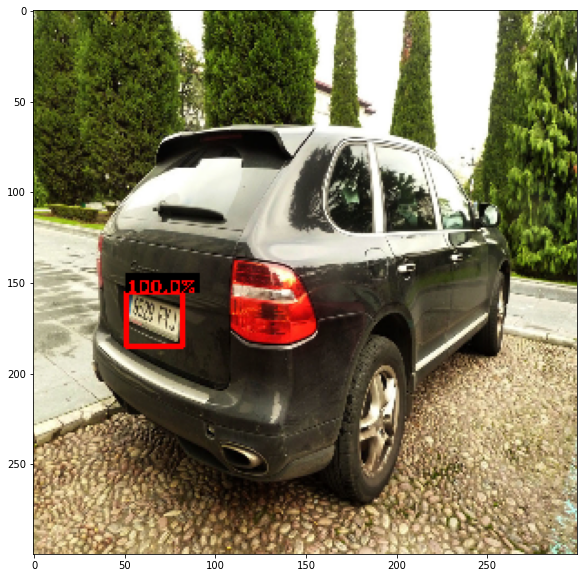

uint8


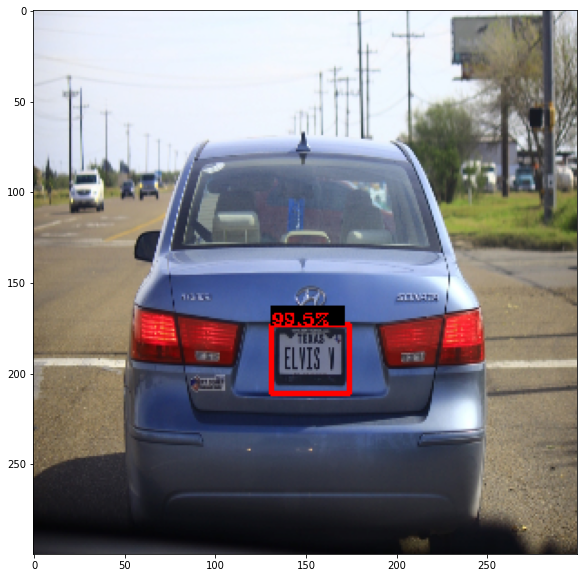

uint8


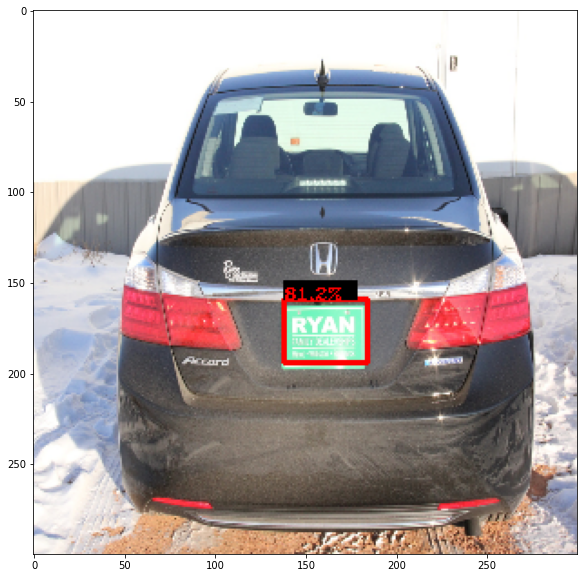

In [ ]:
 # how good our detector works by visualizing the results on the randomly chosen test images:
experiment.draw_bboxes(3, trainer_config)

Tensorboard Logs

In [ ]:
# %load_ext tensorboard
# %reload_ext tensorboard
%tensorboard --logdir=./runs

<IPython.core.display.Javascript object>

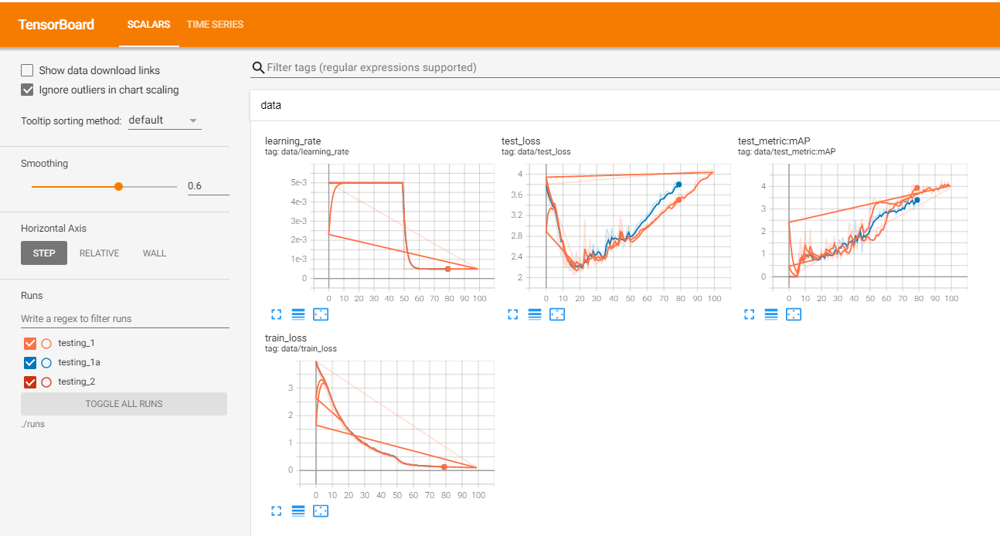

# <font style="color:green">5. Run Inference on a Video [15 Points]</font>

#### [Download the Input Video](https://www.dropbox.com/s/g88o4dx18zpgn8k/projet3-input-video.mp4?dl=1)

**Goal is to run inference on below input video.** 

You can download the video from [here](https://www.dropbox.com/s/g88o4dx18zpgn8k/projet3-input-video.mp4?dl=1).



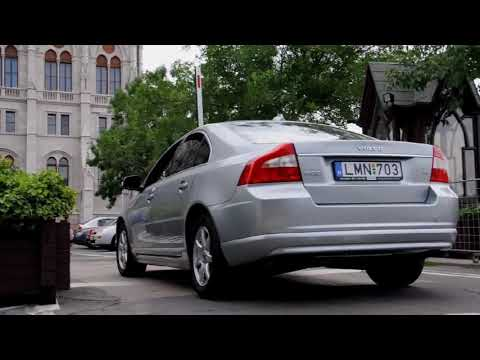

In [ ]:
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("18HWHCevFdU", width=640, height=360)
display(video)

**Final output video has a bounding box around the vehicle registration plate as shown below or check out https://www.youtube.com/watch?v=GuO_ersY9b8**

In [ ]:
video = YouTubeVideo("GuO_ersY9b8", width=640, height=360)
display(video)

#  <font style="color:green">4. COCO Detection Evaluation [25 Points]</font> 

**You have to evaluate your detection model on COCO detection evaluation metric.**

For your reference here is the coco evaluation metric chart:


---

<img src="https://www.learnopencv.com/wp-content/uploads/2020/03/c3-w9-coco_metric.png">

---

#### <font style="color:red">The expected `AP` (primary challenge metric) is more than `0.5`.</font>

**The expected output should look similar to the following:**

```
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.550
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.629
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.256
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.653
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.627
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.504
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.629
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.633
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.380
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.722
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.704
```



#**Note:**
###In order to obtain COCO Detection Evaluation the model has to be trained using the Detectron2 framework, as shown in the following sections. 

###Detectron is an open source object detection platform provided by Facebook AI Research. The goal of Detectron is to provide a high-quality, high-performance codebase for object detection research. 
###It is designed to be flexible in order to support rapid implementation and evaluation of novel research. Including the advancements of the project, Detectron2 is a groundup rewrite of Detectron and written in Pytorch.

In [ ]:
%cd /content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/ 

/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector


In [ ]:
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'


  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-m5ps4gfa
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-m5ps4gfa
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-linux_x86_64.whl size=265563 sha256=80dfb3eec731adebd58498e9f078d589b35c9c5b17d4487fcc22ffb375630446
  Stored in directory: /tmp/pip-ephem-wheel-cache-cxio81kq/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
ERROR: detectron2 0.3+cu101 has requirement pycocotools>=2.0.2, but you'll have pycocotools 2.0 which is incompatible.
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0


In [ ]:
!pip install PyYAML==5.3

In [ ]:
# for CUDA 10.1:
!python -m pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html
Processing /root/.cache/pip/wheels/68/a5/e7/56401832f23d0b2db351c5b682e466cb4841960b086da65e4e/pycocotools-2.0.2-cp36-cp36m-linux_x86_64.whl
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0


In [ ]:
!pip3 install --upgrade Pillow

Requirement already up-to-date: Pillow in /usr/local/lib/python3.6/dist-packages (8.1.0)


In [ ]:
!pwd

/content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector


In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
import os
import matplotlib.pyplot as plt

# model_zoo has lots of pre-trained models
from detectron2 import model_zoo

# DefaultTrainer is a class for training object detector
from detectron2.engine import DefaultTrainer
# DefaultPredictor is class for inference
from detectron2.engine import DefaultPredictor

# detectron2 has its configuration format
from detectron2.config import get_cfg
# detectron2 has implemented Visualizer of object detection
from detectron2.utils.visualizer import Visualizer

# from DatasetCatalog, detectron2 gets dataset and from MetadatCatalog it gets metadata of the dataset
from detectron2.data import DatasetCatalog, MetadataCatalog

# BoxMode supports bounding boxes in different format
from detectron2.structures import BoxMode

# COCOEvaluator based on COCO evaluation metric, inference_on_dataset is used for evaluation for a given metric
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

# build_detection_test_loader, used to create test loader for evaluation
from detectron2.data import build_detection_test_loader

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [ ]:
# %cd /content/drive/MyDrive/ColabNotebooks/Pytorch/Week10/single-stage-detector/ 
!pwd

/content/drive/My Drive/ColabNotebooks/Pytorch/Week10/single-stage-detector


In [ ]:
from trainer.tensorboard_visualizer import TensorBoardVisualizer
from torch.utils.tensorboard import SummaryWriter

class myTensorBoardVisualizer(TensorBoardVisualizer):
  def __init__(self):
        self._writer = SummaryWriter("./runs/testing_1_detectron")

In [ ]:
# write a function that loads the dataset into detectron2's standard format
def get_vehicle_LP_dicts(data_root, txt_file):
    dataset_dicts = []
    filenames = []
    csv_path = os.path.join(data_root, txt_file)
    with open(csv_path, "r") as f:
        for line in f:
            filenames.append(line.rstrip())

    for idx, filename in enumerate(filenames):
        record = {}
        
        image_path = os.path.join(data_root, filename)
        
        height, width = cv2.imread(image_path).shape[:2]
        
        record['file_name'] = image_path
        record['image_id'] = idx
        record['height'] = height
        record['width'] = width
        
        image_filename = os.path.basename(filename)
        image_name = os.path.splitext(image_filename)[0]
        annotation_path = os.path.join(data_root, 'labels', '{}.txt'.format(image_name))
        annotation_rows = []

        with open(annotation_path, "r") as f:
            for line in f:
                temp = line.rstrip().split(" ")
                annotation_rows.append(temp)

        objs = []
        for row in annotation_rows:
            xmin = int(float(row[3]))
            ymin = int(float(row[4]))
            xmax = int(float(row[5]))
            ymax = int(float(row[6]))
    
    
            obj= {
                'bbox': [xmin, ymin, xmax, ymax],
                'bbox_mode': BoxMode.XYXY_ABS,
                # alternatively, we can use bbox_mode = BoxMode.XYWH_ABS
                # 'bbox': [xmin, ymin, bwidth, bheight],
                # 'bbox_mode': BoxMode.XYWH_ABS,
                'category_id': 0,
                'iscrowd': 0
            }
        
            objs.append(obj)
        record['annotations'] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [ ]:
# import os
# # data_root="reg_plate_data/JPEGImages/"
# data_root="reg_plate_data/labels/"
# path, dirs, files = next(os.walk(data_root))

# for file in files:
#   print(file)
#   # with open(file, "r") as f:
#   #   for line in f:
#   #     print(line)
#     # annotation_rows.append(temp)


# # file_count = len(files)
# # print("Total in {}: {}".format(data_root, file_count))


In [ ]:
%cd /content/drive/My Drive/ColabNotebooks/Pytorch/Week10/single-stage-detector/detectron2

/content/drive/My Drive/ColabNotebooks/Pytorch/Week10/single-stage-detector/detectron2


In [ ]:
# configurations

data_root = 'reg_plate_data'
train_txt = 'vehicle_LP_train.txt'
test_txt = 'vehicle_LP_test.txt'

train_data_name = 'vehicle_LP_train'
test_data_name = 'vehicle_LP_test'

thing_classes = ['vehicle_LP']

output_dir = 'outputs'

def count_lines(fname):
    with open(fname) as f:
        for i, l in enumerate(f):
            pass
    return i + 1

train_img_count = count_lines(os.path.join(data_root, train_txt))
test_img_count = count_lines(os.path.join(data_root, test_txt))

print (train_img_count)
print (test_img_count)



5308
386


In [ ]:
# !cp data/VehLPR/train/Vehicle_registration_plate/Label/*.txt detectron2/reg_plate_data/labels/

In [ ]:
!pwd

/content/drive/My Drive/ColabNotebooks/Pytorch/Week10/single-stage-detector/detectron2


Total 5694 = Training 5308+ Test 386

In [ ]:
# Register train and test data
# dataset can be registered only once with one name

# register train data
DatasetCatalog.register(name=train_data_name, 
                        func=lambda: get_vehicle_LP_dicts(data_root, train_txt))
train_metadata = MetadataCatalog.get(train_data_name).set(thing_classes=thing_classes)

# register test data
DatasetCatalog.register(name=test_data_name, 
                        func=lambda: get_vehicle_LP_dicts(data_root, test_txt))
test_metadata = MetadataCatalog.get(test_data_name).set(thing_classes=thing_classes)

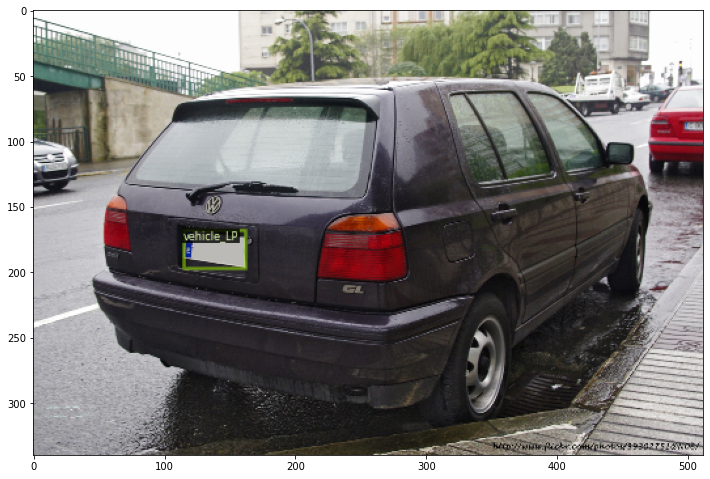

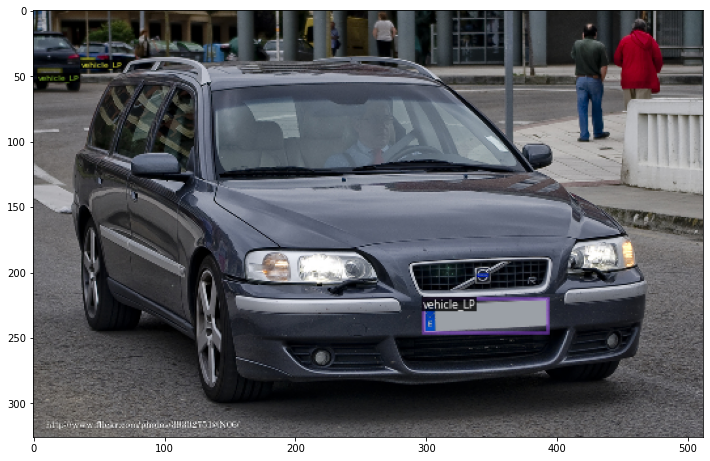

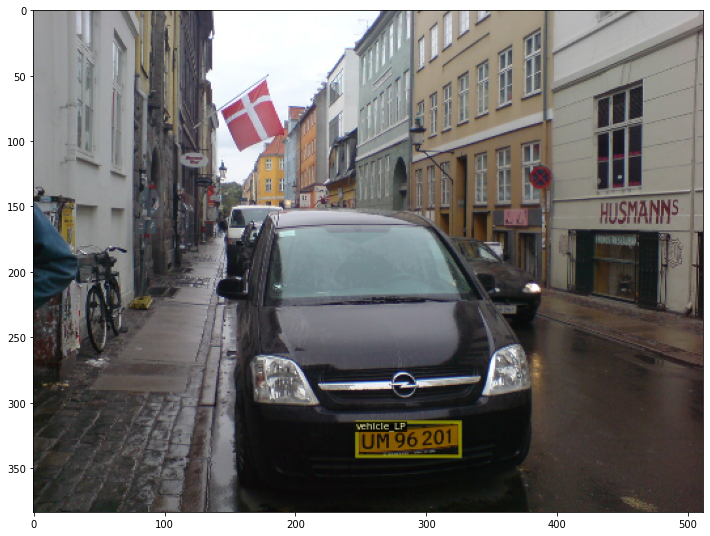

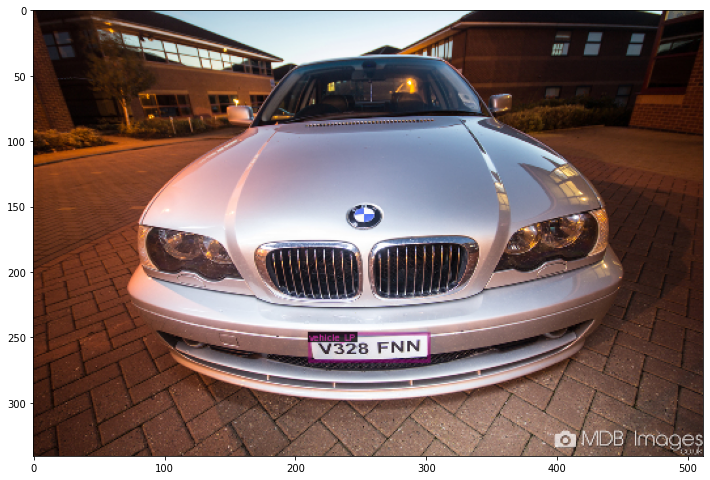

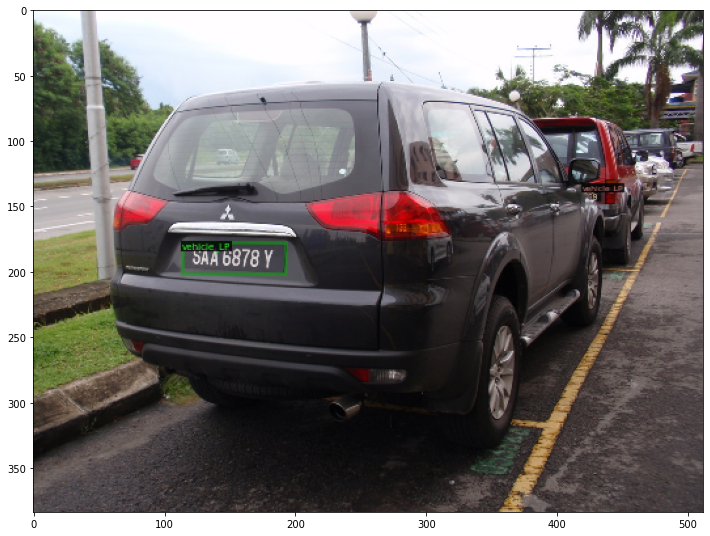

In [ ]:
# visualize the data

test_data_dict = get_vehicle_LP_dicts(data_root, test_txt)

for d in random.sample(test_data_dict, 5):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], 
                            metadata=test_metadata, 
                            scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.figure(figsize = (12, 12))
    plt.imshow(vis.get_image())
    plt.show()

In [ ]:
# detectron2 configuration

# default configuration
cfg = get_cfg()

# update configuration with RetinaNet configuration
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_3x.yaml"))

# We have registered the train and test data set with name traffic_sign_train and traffic_sign_test. 
# Let's replace the detectron2 default train dataset with our train dataset.
cfg.DATASETS.TRAIN = (train_data_name,)

# No metric implemented for the test dataset, we will have to update cfg.DATASET.TEST with empty tuple
cfg.DATASETS.TEST = ()


Loading config /usr/local/lib/python3.6/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


In [ ]:
# data loader configuration
cfg.DATALOADER.NUM_WORKERS = 4

In [ ]:
# solver configuration

# batch size
cfg.SOLVER.IMS_PER_BATCH = 4

# choose a good learning rate
cfg.SOLVER.BASE_LR = 0.001

# We need to specify the number of iteration for training in detectron2, not the number of epochs.
# lets convert number of epoch to number or iteration (max iteration)

epoch = 2
max_iter = int(epoch * train_img_count / cfg.SOLVER.IMS_PER_BATCH)
max_iter = 8000

cfg.SOLVER.MAX_ITER = max_iter 

In [ ]:
# number of output class
# we have only one class that is Traffic Sign
cfg.MODEL.RETINANET.NUM_CLASSES = len(thing_classes)

In [ ]:
# update create ouptput directory 
cfg.OUTPUT_DIR = output_dir
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

In [ ]:
!pwd

/content/drive/My Drive/ColabNotebooks/Pytorch/Week10/single-stage-detector/detectron2


In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
# %reload_ext tensorboard
%tensorboard --logdir outputs

In [ ]:
# training

# Create a trainer instance with the configuration.
trainer = DefaultTrainer(cfg) 

# if resume=False, because we don't have trained model yet. It will download model from model url and load it
trainer.resume_or_load(resume=False)

# start training
# trainer.train()

[01/17 18:35:30 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

R-50.pkl: 102MB [00:04, 22.0MB/s]                           


[01/17 18:36:55 d2.checkpoint.c2_model_loading]: Remapping C2 weights ......
[01/17 18:36:55 d2.checkpoint.c2_model_loading]: backbone.bottom_up.res2.0.conv1.norm.bias            loaded from res2_0_branch2a_bn_beta           of shape (64,)
[01/17 18:36:55 d2.checkpoint.c2_model_loading]: backbone.bottom_up.res2.0.conv1.norm.running_mean    loaded from res2_0_branch2a_bn_running_mean   of shape (64,)
[01/17 18:36:55 d2.checkpoint.c2_model_loading]: backbone.bottom_up.res2.0.conv1.norm.running_var     loaded from res2_0_branch2a_bn_running_var    of shape (64,)
[01/17 18:36:55 d2.checkpoint.c2_model_loading]: backbone.bottom_up.res2.0.conv1.norm.weight          loaded from res2_0_branch2a_bn_gamma          of shape (64,)
[01/17 18:36:55 d2.checkpoint.c2_model_loading]: backbone.bottom_up.res2.0.conv1.weight               loaded from res2_0_branch2a_w                 of shape (64, 64, 1, 1)
[01/17 18:36:55 d2.checkpoint.c2_model_loading]: backbone.bottom_up.res2.0.conv2.norm.bias         

In [ ]:
!pwd

/content/drive/My Drive/ColabNotebooks/Pytorch/Week10/single-stage-detector/detectron2


In [ ]:
# inference on our fine-tuned model

# By default detectron2 save the model with name model_final.pth
# update the model path in configuration that will be used to load the model
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")


# update RetinaNet score threshold 
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5

cfg.DATASETS.TEST = (test_data_name,)

# create a predictor instance with the configuration (it has our fine-tuned model)
# this predictor does prdiction on a single image
predictor = DefaultPredictor(cfg)


reg_plate_data/JPEGImages/628a23a43f19c4db.jpg
{'instances': Instances(num_instances=1, image_height=576, image_width=1024, fields=[pred_boxes: Boxes(tensor([[131.7105, 363.0377, 254.7519, 448.7391]], device='cuda:0')), scores: tensor([0.9066], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


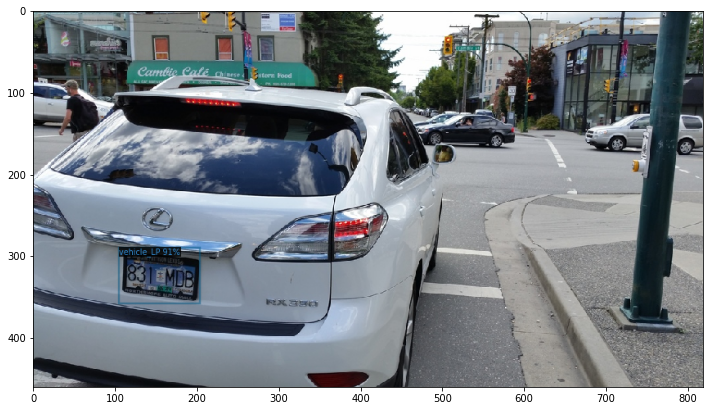

reg_plate_data/JPEGImages/da1352ab6054a2e4.jpg
{'instances': Instances(num_instances=1, image_height=766, image_width=1024, fields=[pred_boxes: Boxes(tensor([[192.9524, 358.0749, 779.9377, 655.2316]], device='cuda:0')), scores: tensor([0.9652], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


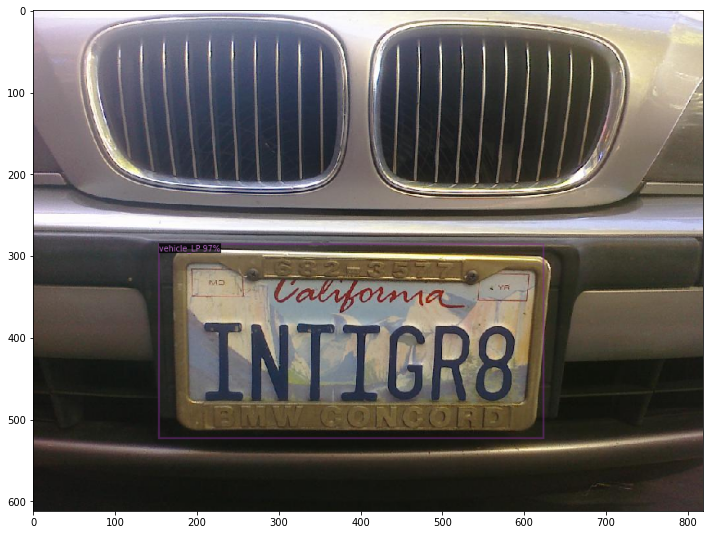

reg_plate_data/JPEGImages/3241f09a8964ddfb.jpg
{'instances': Instances(num_instances=2, image_height=768, image_width=1024, fields=[pred_boxes: Boxes(tensor([[337.3462, 514.0137, 394.3409, 551.8989],
        [874.1183, 368.4391, 905.9770, 390.0398]], device='cuda:0')), scores: tensor([0.9648, 0.5685], device='cuda:0'), pred_classes: tensor([0, 0], device='cuda:0')])}


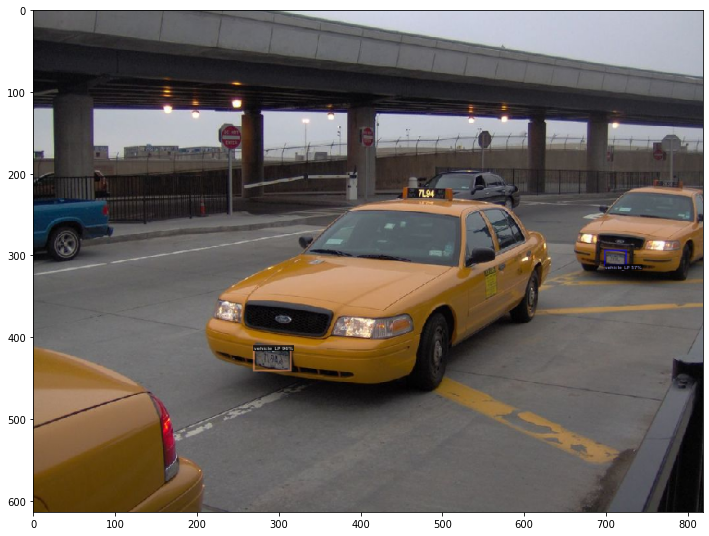

In [ ]:
# let's have a look at the predictions

for d in random.sample(test_data_dict, 3):
    print(d["file_name"])
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    print(outputs)
    v = Visualizer(im[:, :, ::-1],
                   metadata=test_metadata, 
                   scale=0.8
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (12, 12))
    plt.imshow(v.get_image())
    plt.show()

In [ ]:
!pwd

/content/drive/My Drive/ColabNotebooks/Pytorch/Week10/single-stage-detector/detectron2


In [ ]:

# create directory for evaluation
eval_dir = os.path.join(cfg.OUTPUT_DIR, 'coco_eval')
os.makedirs(eval_dir, exist_ok=True)

# create evaluator instance with coco evaluator
evaluator = COCOEvaluator(dataset_name=test_data_name, 
                          tasks=cfg, 
                          distributed=False, 
                          output_dir=eval_dir)

# create validation data loader
val_loader = build_detection_test_loader(cfg, test_data_name)

# start validation
inference_on_dataset(trainer.model, val_loader, evaluator)

In [ ]:

# create directory for evaluation
eval_dir = os.path.join(cfg.OUTPUT_DIR, 'coco_eval')
os.makedirs(eval_dir, exist_ok=True)

# create evaluator instance with coco evaluator
evaluator = COCOEvaluator(dataset_name=test_data_name, 
                          tasks=cfg, 
                          distributed=False, 
                          output_dir=eval_dir)

# create validation data loader
val_loader = build_detection_test_loader(cfg, test_data_name)

# start validation
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [01/12 17:26:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/12 17:26:57 d2.evaluation.coco_evaluation]: 'vehicle_LP_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
WARNING [01/12 17:26:57 d2.data.datasets.coco]: Using previously cached COCO format annotations at 'outputs/coco_eval/vehicle_LP_test_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[01/12 17:27:03 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
| vehicle_LP | 512          |
|            |              |
[01/12 17:27:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/12 17:27:03 d2.data.common]: Serializing 386 elements to byte tensors and

OrderedDict([('bbox',
              {'AP': 40.81445902819875,
               'AP50': 80.48146123604052,
               'AP75': 36.32421425628441,
               'APl': 48.462601496533836,
               'APm': 48.375168494658254,
               'APs': 17.107302948885973})])

##Below code runs inference using the above trained model on the input Video file.

In [ ]:
def video_read_write(video_path):
    """
    Read video frames one-by-one, flip it, and write in the other video.
    video_path (str): path/to/video
    """
    video = cv2.VideoCapture(video_path)
    
    # Check if camera opened successfully
    if not video.isOpened(): 
        print("Error opening video file")
        return
    
    # create video writer
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
    frames_per_second = video.get(cv2.CAP_PROP_FPS)
    num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    
    output_fname = '{}_out.mp4'.format(os.path.splitext(video_path)[0])
    
    output_file = cv2.VideoWriter(
        filename=output_fname,
        # some installation of opencv may not support x264 (due to its license),
        # you can try other format (e.g. MPEG)
        fourcc=cv2.VideoWriter_fourcc(*"x264"),
        fps=float(frames_per_second),
        frameSize=(width, height),
        isColor=True,
    )
    
        
    i = 0
    while video.isOpened():
        ret, frame = video.read()
        if ret:
            experiment.inference(frame, trainer_config)
            output_file.write(frame[:, ::-1, :])
#             cv2.imwrite('anpd_out/frame_{}.png'.format(str(i).zfill(3)), frame[:, ::-1, :])
            i += 1
        else:
            break
        
    video.release()
    output_file.release()
    
    return

In [ ]:
video_read_write("projet3-input-video.mp4")